# Lab 03

In [1]:
import numpy as np
import pandas as pd
import cv2
from matplotlib import pyplot as plt
from pylab import imread
from skimage import data
from skimage.color import rgb2gray

C:\Users\PC\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
# Xử lý đường dẫn
import os
import requests
os.chdir('C:/Users/PC/Desktop/CODE/PY/DIP/lab03/image')

### Hàm show ảnh

In [3]:
def imshows(ImageData, LabelData, rows, cols, gridType = False):
  # Convert ImageData and LabelData to List
  from matplotlib import pyplot as plt
  ImageArray = list(ImageData)
  LabelArray = list(LabelData)
  if(rows == 1 & cols == 1):
    fig = plt.figure(figsize=(20,20))
  else:
    fig = plt.figure(figsize=(cols*8,rows*5))
        
  for i in range(1, cols * rows + 1):
      fig.add_subplot(rows, cols, i)
      image = ImageArray[i - 1]
      # Nếu số kênh màu nhỏ hơn 3 thì ta trình chiếu ảnh đen trắng
      # ngược lại thì trình chiếu ảnh màu
      if (len(image.shape) < 3):
          plt.imshow(image, plt.cm.gray)
          plt.grid(gridType)
      else:
          plt.imshow(image)
          plt.grid(gridType)
      plt.title(LabelArray[i - 1])
  plt.show()

def ShowThreeImages(IM1, IM2, IM3):
    imshows([IM1, IM2, IM3], ["Ảnh 1","Ảnh 2", "Ảnh 3"], 1, 3)
def ShowTwoImages(IM1, IM2):
    imshows([IM1, IM2], ["Ảnh 1","Ảnh 2"], 1, 2)
def ShowOneImage(IM):
    imshows([IM], ["Ảnh"], 1, 1)
def ShowListImages(listImage, row, col):
    listCaption = []
    for i in range(len(listImage)):
        listCaption.append(str(i))
    imshows(listImage,listCaption,row,col)

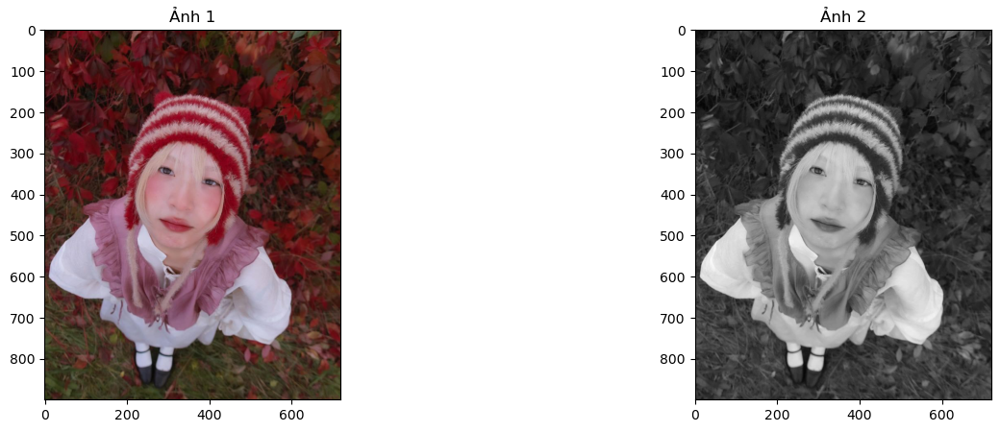

In [4]:
# Read Image 
image_1 = imread("image_thachtrang.jpg")
# Convert Image into Gray: Chuyển thành ảnh xám
image_1_gray = cv2.cvtColor(image_1, cv2.COLOR_RGB2GRAY)

# Display Image: Hiển thị ảnh
ShowTwoImages(image_1, image_1_gray)

## Bài 1

### Làm mờ ảnh với kernel 3x3 và 5x5 
Kernel : là ma trận nhỏ được dùng để làm mờ, làm rõ,....

Filtering kernel 3x3:


array([[0.11111111, 0.11111111, 0.11111111],
       [0.11111111, 0.11111111, 0.11111111],
       [0.11111111, 0.11111111, 0.11111111]], dtype=float32)

Filtering kernel 5x5:


array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

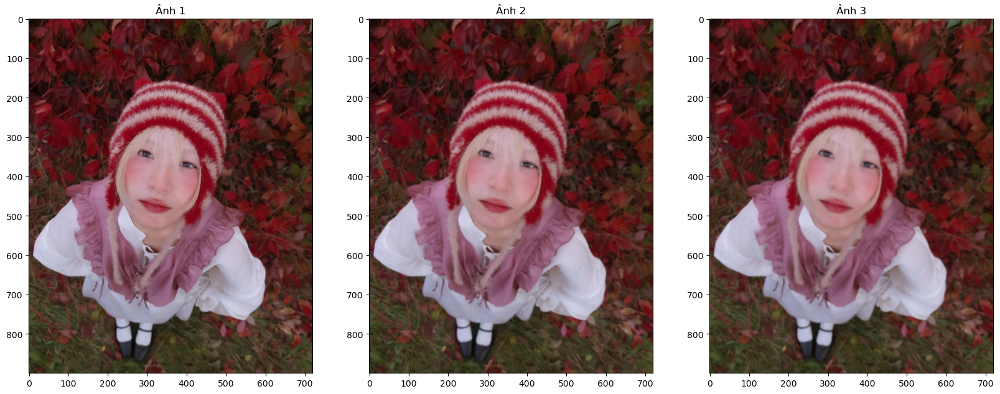

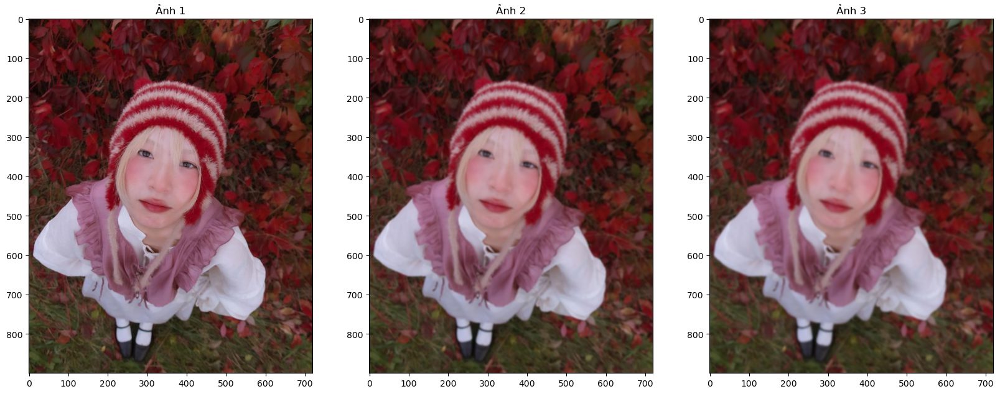

In [5]:
kernel_33 = np.ones((3,3),np.float32)/9
kernel_55 = np.ones((5,5),np.float32)/25
print('Filtering kernel 3x3:')
display(kernel_33)
print('Filtering kernel 5x5:')
display(kernel_55)

image_33_1 = cv2.filter2D(image_1,-1,kernel_33)
image_33_2 = cv2.filter2D(image_33_1,-1,kernel_33)

image_55_1 = cv2.filter2D(image_1,-1, kernel_55)
image_55_2 = cv2.filter2D(image_55_1,-1,kernel_55)

ShowThreeImages(image_1,image_33_1,image_33_2)
ShowThreeImages(image_1,image_55_1,image_55_2)

### Xuất giá trị đo mức độ mờ 

In [6]:
def variance_of_laplacian(image):
    # tính toán Laplacian của hình ảnh và sau đó trả về tiêu điểm
    # measure, đơn giản là phương sai của Laplacian
  return cv2.Laplacian(image,cv2.CV_64F).var()

blur_measurement = variance_of_laplacian(image_1)
# 3x3
bm_33_1 = variance_of_laplacian(image_33_1)
bm_33_2 = variance_of_laplacian(image_33_2)
# 5x5
bm_55_1 = variance_of_laplacian(image_55_1)
bm_55_2 = variance_of_laplacian(image_55_2)

print("Blur Measurement of image:", blur_measurement)
print("Blur Measurement of image_filter_3_3_01:", bm_33_1)
print("Blur Measurement of image_filter_3_3_02:", bm_33_2)
print("Blur Measurement of image_filter_5_5_01:", bm_55_1)
print("Blur Measurement of image_filter_5_5_02:", bm_55_2)

Blur Measurement of image: 124.6569728375745
Blur Measurement of image_filter_3_3_01: 16.740473220439807
Blur Measurement of image_filter_3_3_02: 8.740040628003596
Blur Measurement of image_filter_5_5_01: 6.464962447225772
Blur Measurement of image_filter_5_5_02: 3.484416151145396


### Viết dòng thông tin về giá trị mức độ mờ trên ảnh

In [7]:
def text_Blur(bm,image):
  text = "Blur measurement"
  fm = bm
  cv2.putText(image,"{}: {:.2f}".format(text,fm),(10,30),cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)
  ShowOneImage(image)

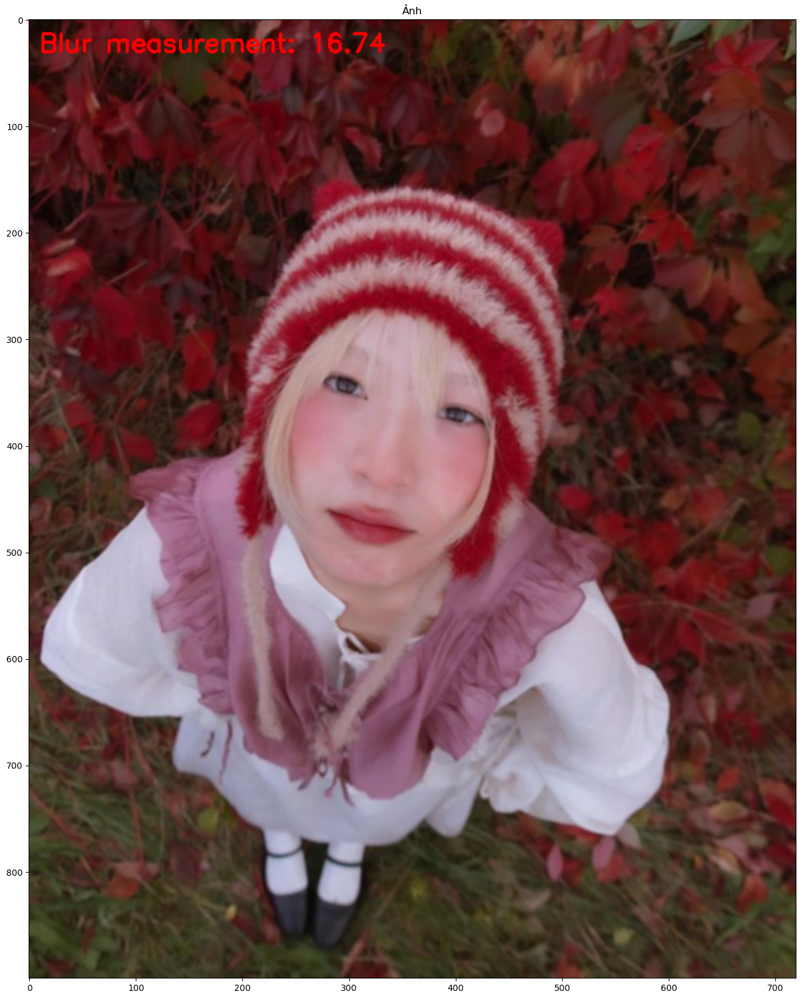

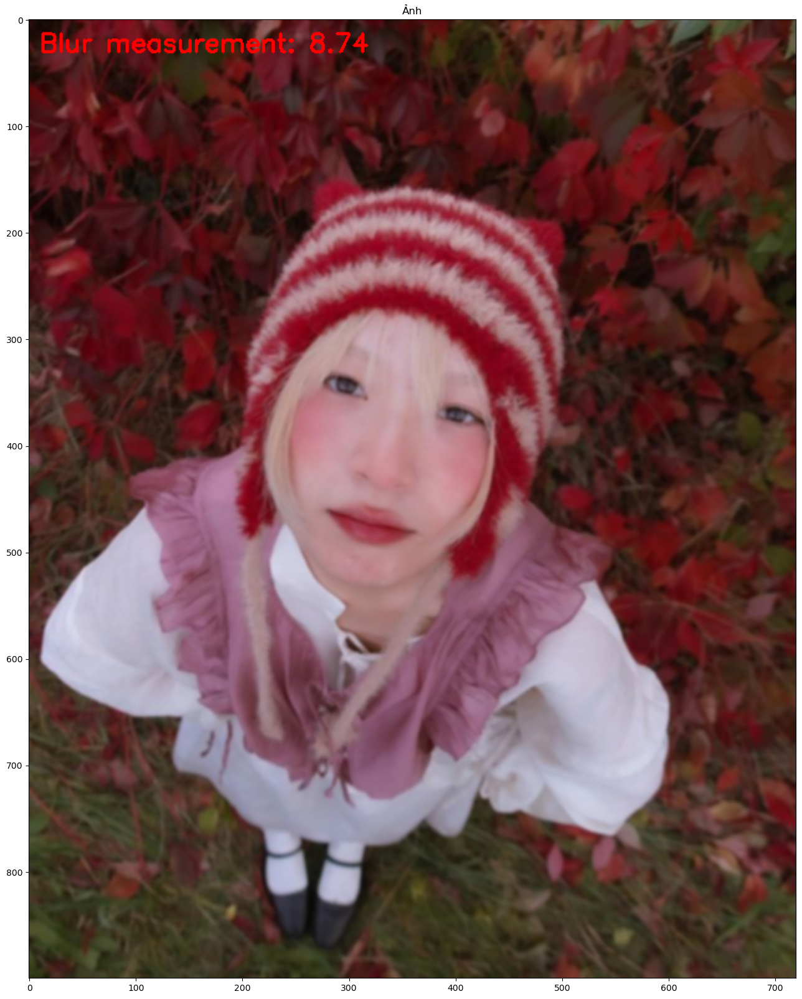

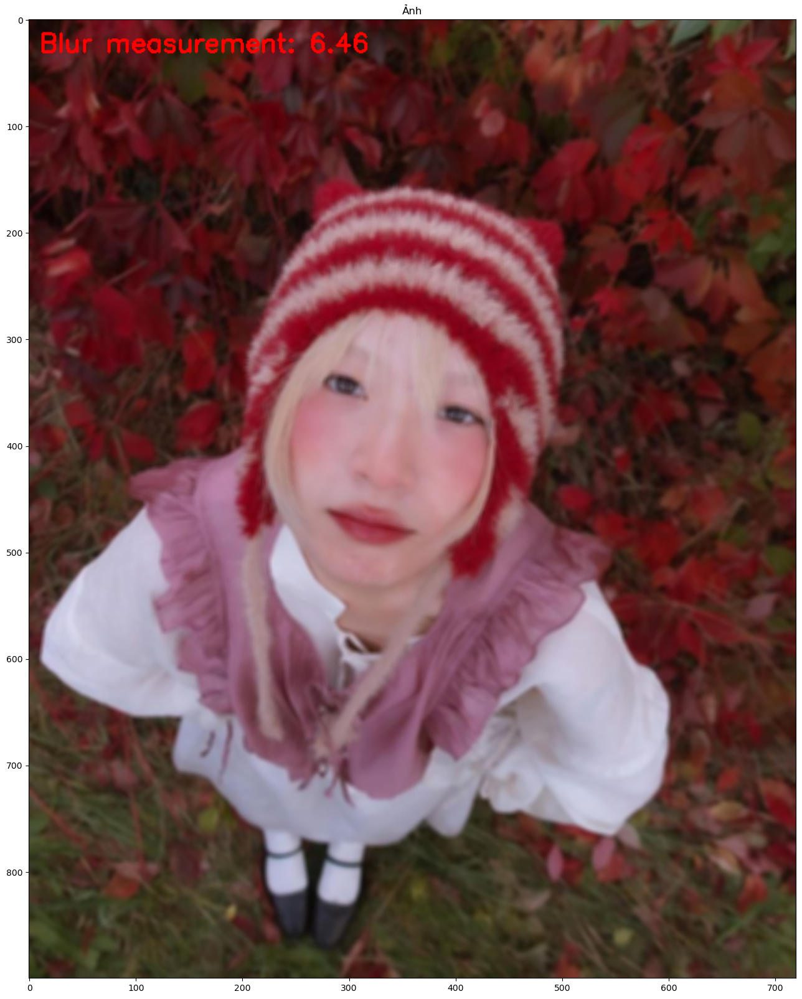

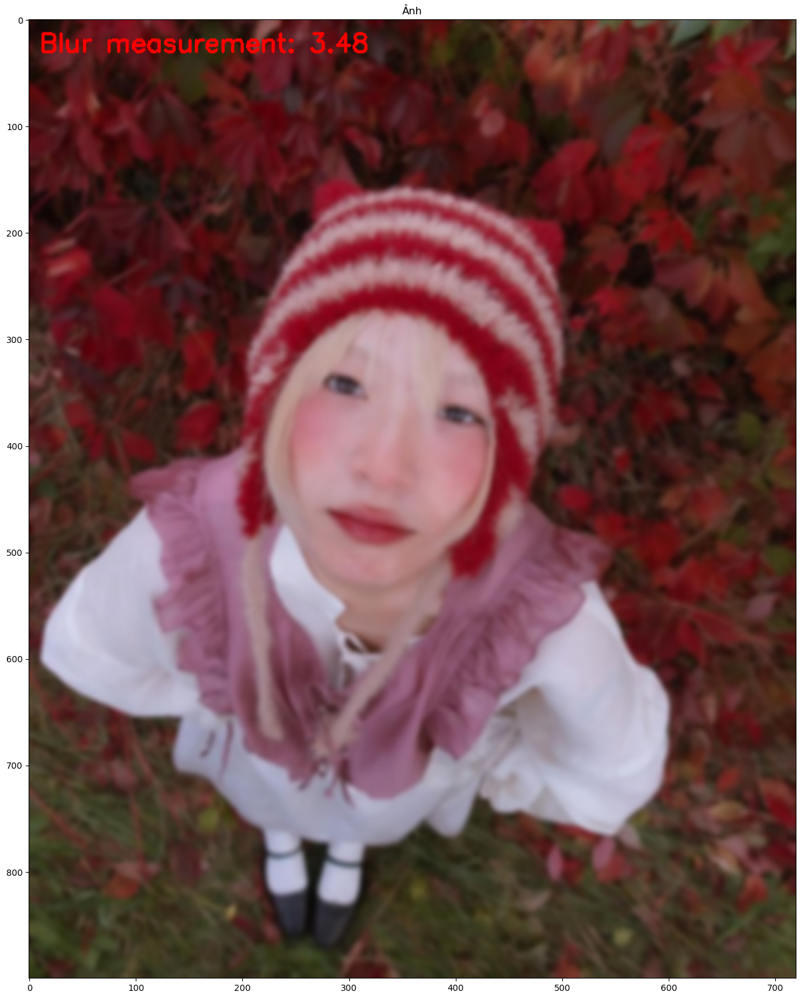

In [8]:
# Blur measurement của ảnh màu
text_Blur(bm_33_1,image_33_1)
text_Blur(bm_33_2,image_33_2)
text_Blur(bm_55_1,image_55_1)
text_Blur(bm_55_2,image_55_2)

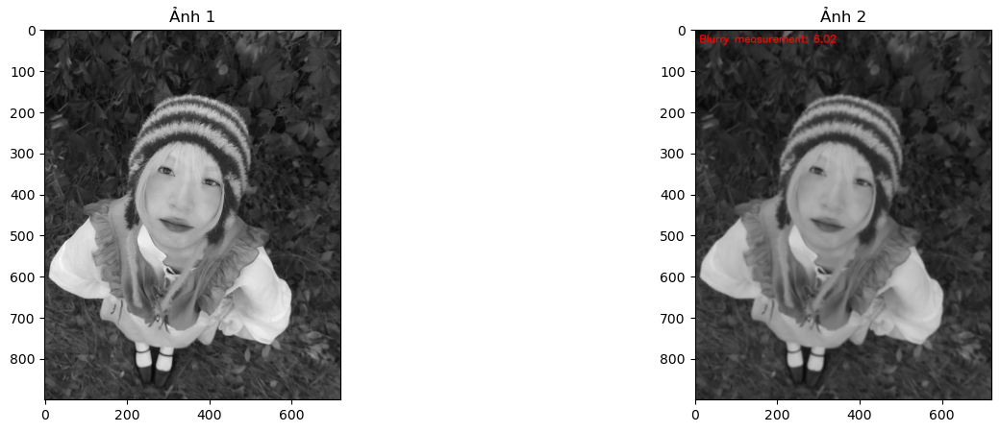

In [9]:
# Blur mearsure của ảnh xám
image_1_gray_filter = cv2.filter2D(image_1_gray,-1,kernel_55)
image_1_gray_filter_color = cv2.cvtColor(image_1_gray_filter, cv2.COLOR_GRAY2RGB)
text = "Blurry measurement"
fm = variance_of_laplacian(image_1_gray_filter)
cv2.putText(image_1_gray_filter_color, "{}: {:.2f}".format(text, fm), (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)
ShowTwoImages(image_1_gray, image_1_gray_filter_color)

## Bài 2

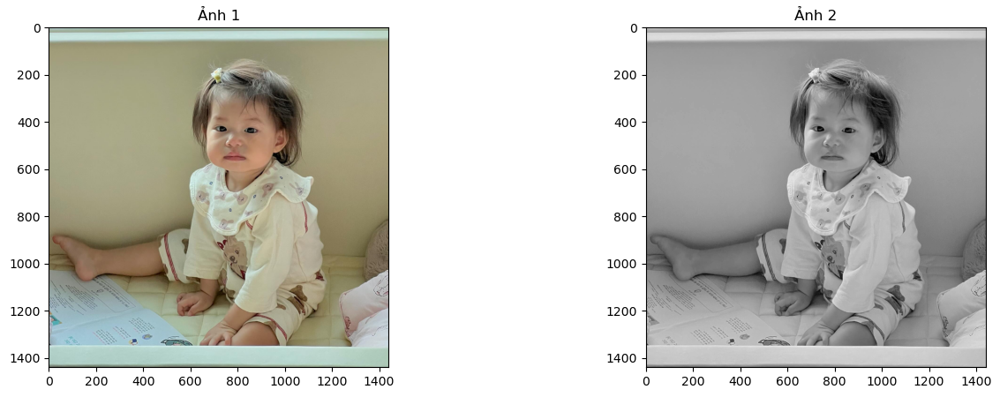

In [10]:
# Read Image 
image_2 = imread("image_pam.jpg")
# Convert Image into Gray: Chuyển thành ảnh xám
image_2_gray = cv2.cvtColor(image_2, cv2.COLOR_RGB2GRAY)

# Display Image: Hiển thị ảnh
ShowTwoImages(image_2, image_2_gray)

### Làm rõ ảnh với các kernel 3x3 và 5x5

Filtering kernel sharpen 3x3:


array([[-1, -1, -1],
       [-1,  9, -1],
       [-1, -1, -1]])

Filtering kernel sharpen 5x5:


array([[-1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1],
       [-1, -1, 25, -1, -1],
       [-1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1]])

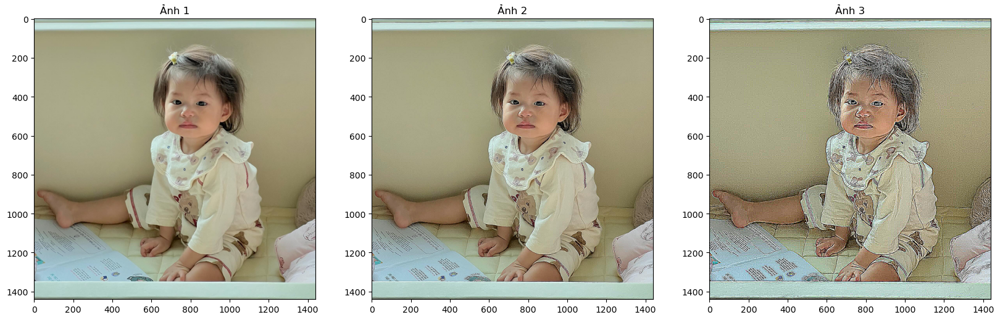

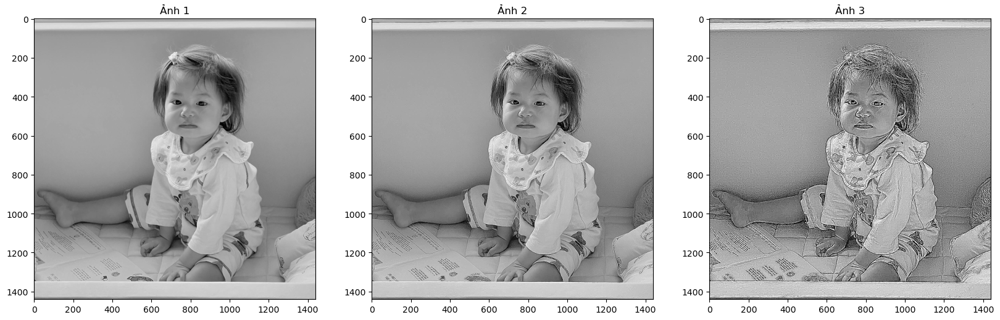

In [11]:
kernel_sharpen_33 = np.array([[-1, -1, -1],
                              [-1, 9, -1],
                              [-1, -1, -1]])
kernel_sharpen_55 = np.array([[-1, -1, -1,-1,-1],
                              [-1, -1, -1,-1,-1],
                              [-1, -1, 25,-1,-1],
                              [-1, -1, -1,-1,-1],
                              [-1, -1, -1,-1,-1]],dtype = int)
print("Filtering kernel sharpen 3x3:")
display(kernel_sharpen_33)
print("Filtering kernel sharpen 5x5:")
display(kernel_sharpen_55)

image_sharpen_1 = cv2.filter2D(image_2,-1,kernel_sharpen_33)
image_gray_sharpen_1 = cv2.filter2D(image_2_gray, -1, kernel_sharpen_33)

image_sharpen_2 = cv2.filter2D(image_2,-1,kernel_sharpen_55)
image_gray_sharpen_2 = cv2.filter2D(image_2_gray, -1, kernel_sharpen_55)

ShowThreeImages(image_2, image_sharpen_1, image_sharpen_2)
ShowThreeImages(image_2_gray, image_gray_sharpen_1, image_gray_sharpen_2)

### Xuất giá trị đo mức độ rõ 

In [12]:
print("Giá trị đo mức độ rõ của ảnh màu:",variance_of_laplacian(image_2))
print("Giá trị đo mức độ rõ của ảnh xám:",variance_of_laplacian(image_2_gray))

print("Giá trị đo mức độ rõ của ảnh màu 3x3:",variance_of_laplacian(image_sharpen_1))
print("Giá trị đo mức độ rõ của ảnh xám 3x3:", variance_of_laplacian(image_gray_sharpen_1))

print("Giá trị đo mức độ rõ của ảnh màu 5x5:",variance_of_laplacian(image_sharpen_2))
print("Giá trị đo mức độ rõ của ảnh xám 5x5:",variance_of_laplacian(image_gray_sharpen_2))

Giá trị đo mức độ rõ của ảnh màu: 168.19158527257562
Giá trị đo mức độ rõ của ảnh xám: 166.57315322430475
Giá trị đo mức độ rõ của ảnh màu 3x3: 5496.434589297294
Giá trị đo mức độ rõ của ảnh xám 3x3: 5381.633149487025
Giá trị đo mức độ rõ của ảnh màu 5x5: 15348.835372676283
Giá trị đo mức độ rõ của ảnh xám 5x5: 14910.544140212722


### Viết dòng thông tin về giá trị mức độ rõ trên ảnh

In [13]:
def text_Sharpen(image):
  text = "Sharpen measurement"
  fm = variance_of_laplacian(image)
  cv2.putText(image,"{}: {:.2f}".format(text,fm),(10,30),cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)
  ShowOneImage(image)

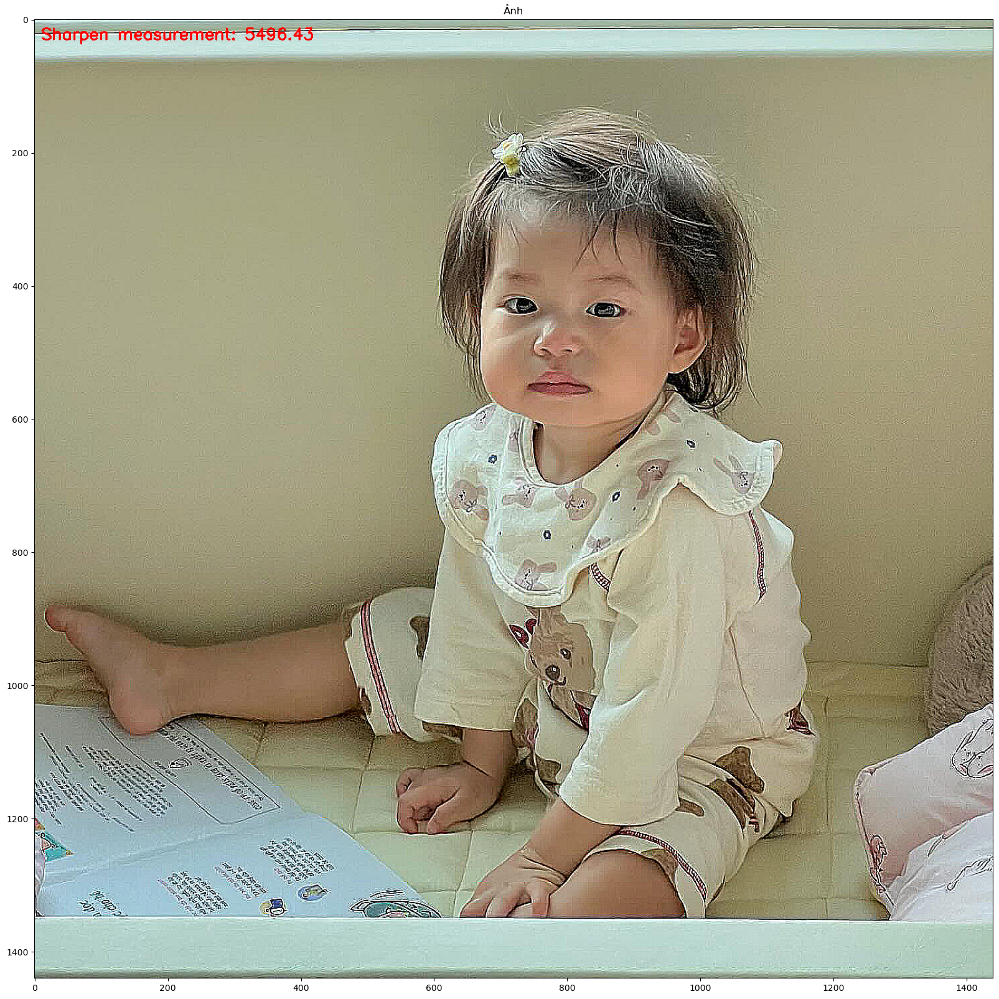

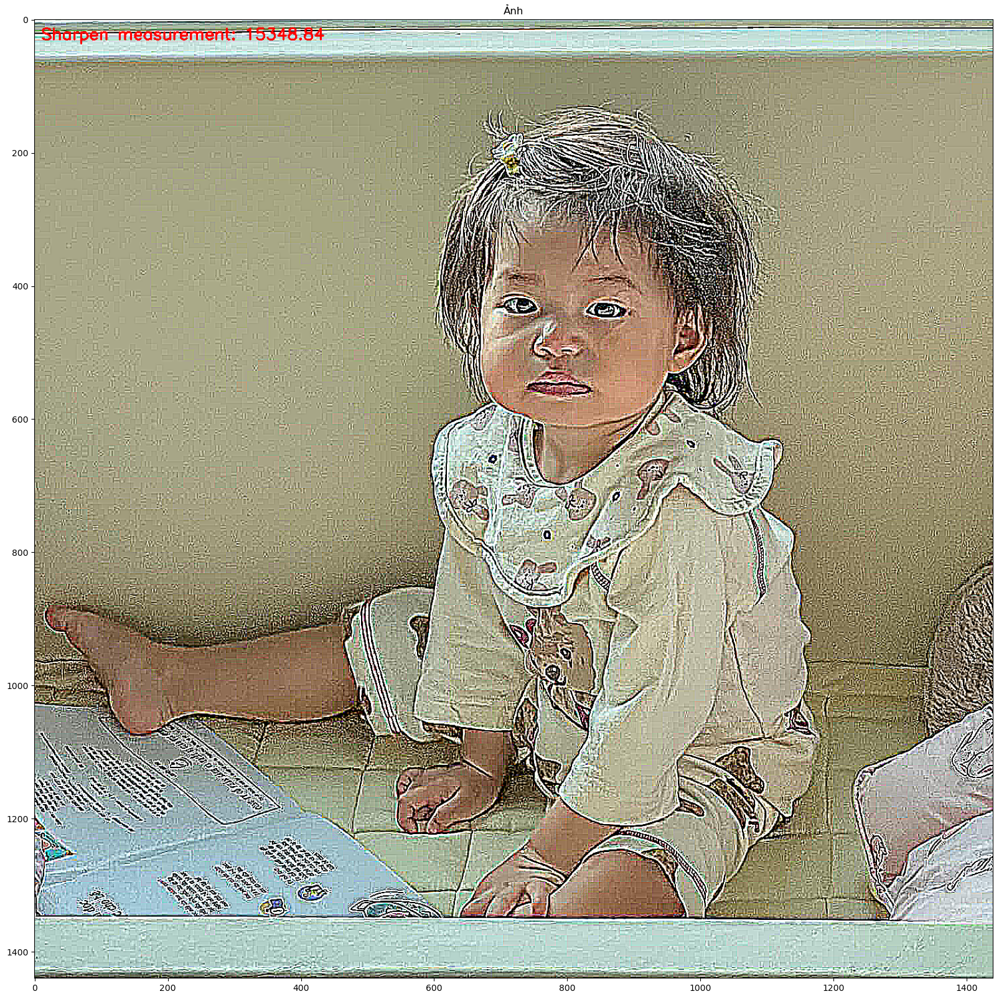

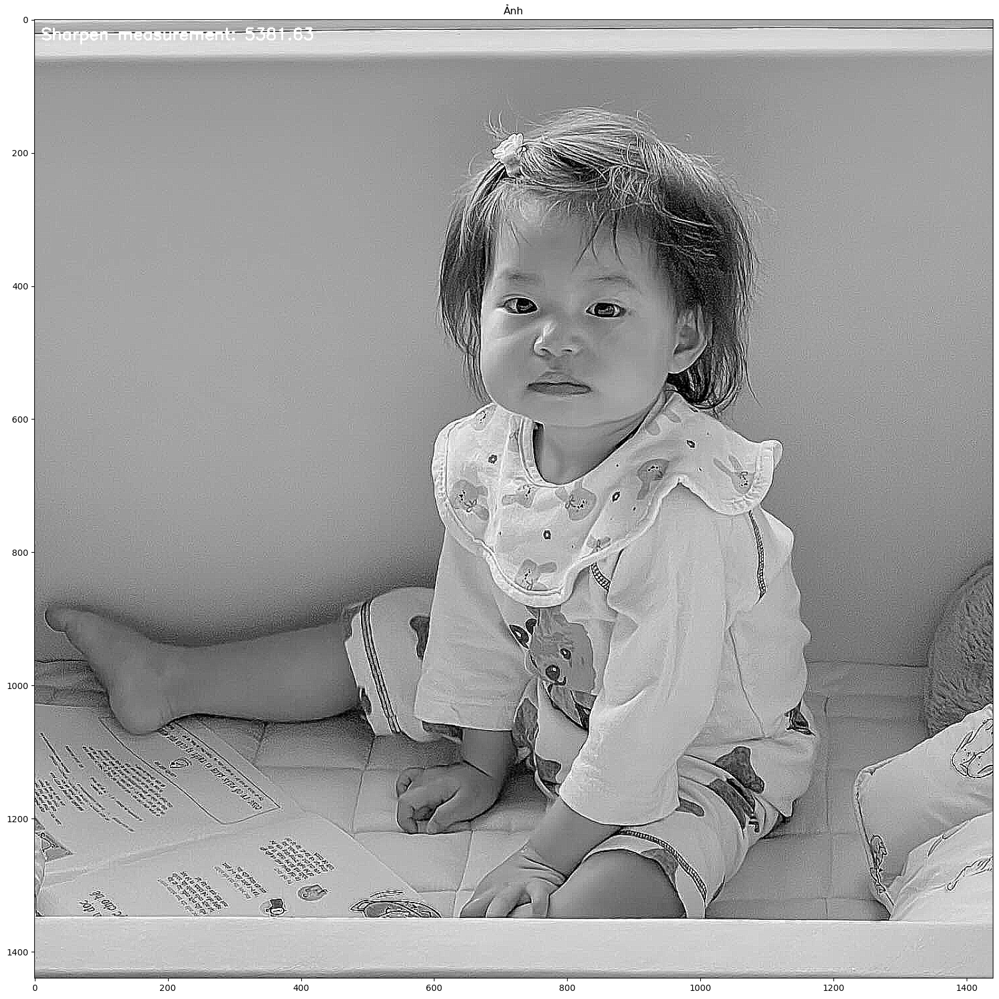

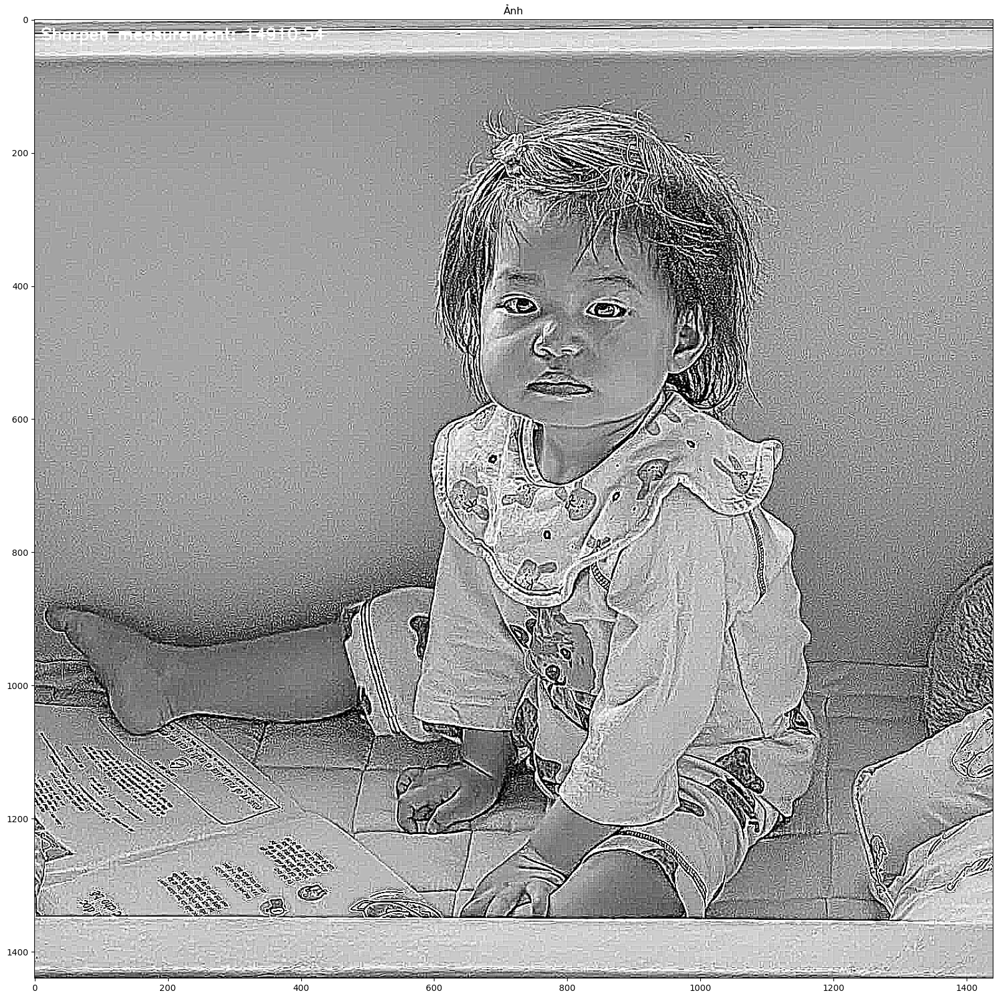

In [14]:
text_Sharpen(image_sharpen_1)
text_Sharpen(image_sharpen_2)
text_Sharpen(image_gray_sharpen_1)
text_Sharpen(image_gray_sharpen_2)

## Bài 3

### Viết hàm đọc toàn bộ ảnh trong thư mục “Image_Input” đó vào một List ảnh

In [15]:
# Create input folder if not exist
input_dir = './Image_Input'
if not os.path.exists(input_dir):
    os.makedirs(input_dir)

In [16]:
# Create output folder if not exist
output_dir = './Image_BlurDetection_Output'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

In [17]:
input_dir = './Image_Input'
image_list = os.listdir(input_dir)

### Định nghĩa ngưỡng mờ dựa trên giá độ đo mờ


In [18]:
blur_threshold = 150

### Đọc lần lượt các ảnh : nếu ảnh nào ngoài ngưỡng mờ ta ghi một dòng thông tin trên ảnh là “Blur Image :” kèm giá trị mờ. Nếu ảnh nào tốt thì ta ghi “Good Image” trên ảnh. 


In [19]:
for image_name in image_list:
    image_path = os.path.join(input_dir, image_name)
    image = cv2.imread(image_path)

    if image is not None:
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        blur_score = cv2.Laplacian(gray_image, cv2.CV_64F).var()

        if blur_score < blur_threshold:
            # Blur image
            cv2.putText(image, "{}: {:.2f}".format("Blur Image", blur_score), (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 2)

        else:
            # Good image
            cv2.putText(image, 'Good Image', (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 2)

        # Save image
        output_path = os.path.join(output_dir, image_name)
        cv2.imwrite(output_path, image)

### Lưu các ảnh được đánh giá vào thư mục “Image_BlurDetection_Output”

In [20]:
os.chdir(output_dir)

### Hiện thị các ảnh đã được đánh giá

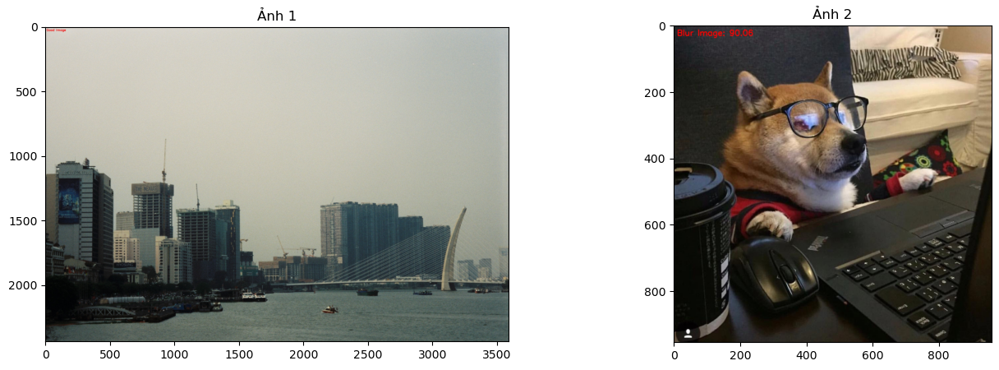

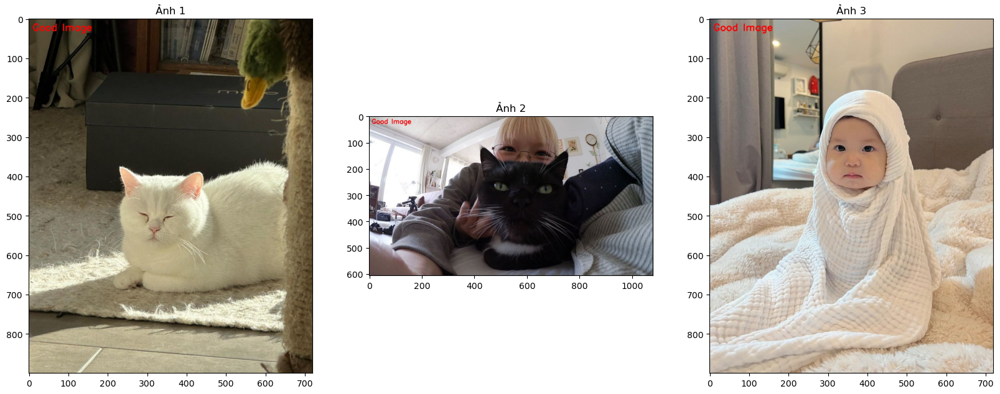

In [21]:
list_images = []
for image_name in image_list:
    list_images.append(imread(image_name))

ShowTwoImages(list_images[0],list_images[1])
ShowThreeImages(list_images[2],list_images[3],list_images[4])

## Bài 4

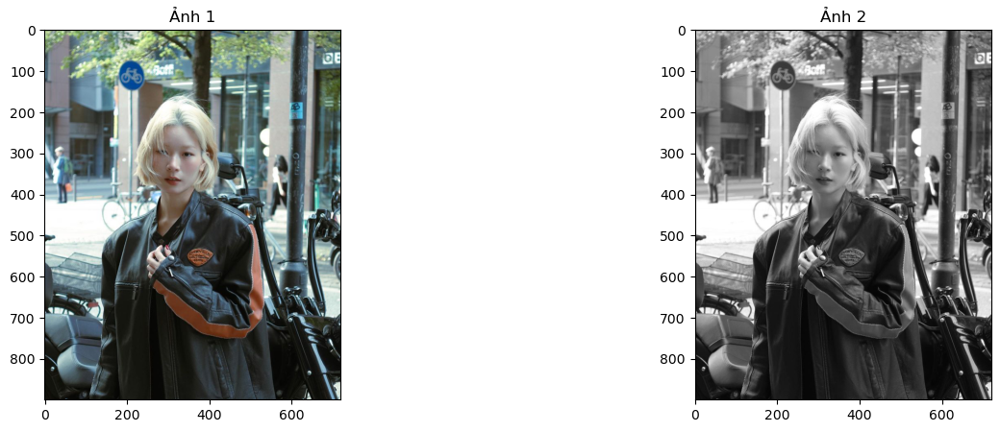

In [22]:
# Read Image
os.chdir('C:/Users/PC/Desktop/CODE/PY/DIP/lab03/image')
image_4 = imread("image_20s.jpg")
# Convert Image into Gray: Chuyển thành ảnh xám
image_4_gray = cv2.cvtColor(image_4, cv2.COLOR_RGB2GRAY)

# Display Image: Hiển thị ảnh
ShowTwoImages(image_4, image_4_gray)

### Xuất ảnh từng điểm ảnh hiển thị giá trị RGBMax

In [23]:
def max_rgb_filter(image):
    # Chia ảnh ra 3 kênh màu riêng biệt
    (B, G, R) = cv2.split(image)
    # tìm giá trị cường độ pixel tối đa cho mỗi
    # tọa độ (x,y), sau đó đặt tất cả giá trị nhỏ hơn M = 0
    M = np.maximum(np.maximum(R, G), B)
    R[R < M] = 0
    G[G < M] = 0
    B[B < M] = 0
    # Hợp nhất các kênh màu lại với nhau
    return cv2.merge([B, G, R])

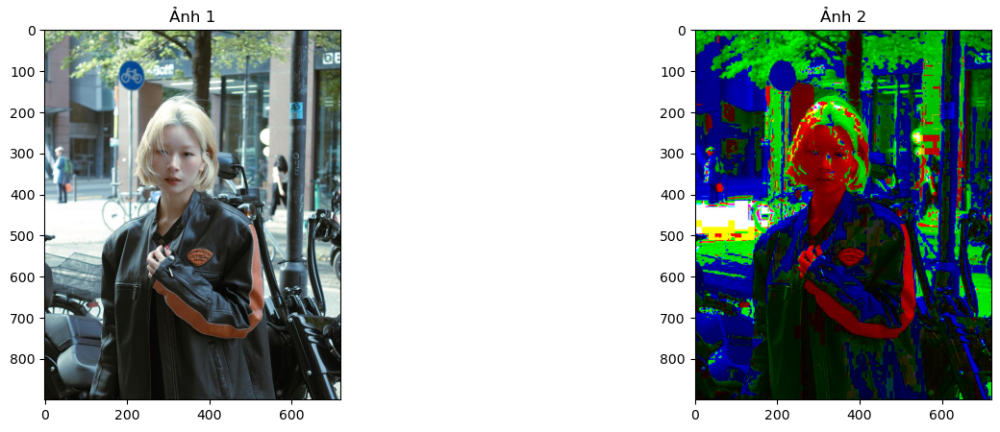

In [24]:
image_4_rgbmax = max_rgb_filter(image_4)
ShowTwoImages(image_4, image_4_rgbmax)

### Xuất các vị trí có giá trị R đạt max, G đạt max và B đạt max

In [25]:
def max_rgb_finder(image):
    # Split the image into its BGR components
    (B, G, R) = cv2.split(image)

    # Find the maximum pixel intensity values for each channel
    max_R = np.max(R)
    max_G = np.max(G)
    max_B = np.max(B)

    # Find the positions where R, G, and B reach their max values
    max_R_indices = np.argwhere(R == max_R)
    max_G_indices = np.argwhere(G == max_G)
    max_B_indices = np.argwhere(B == max_B)

    # Set all pixel values less than the max values to zero
    R[R < max_R] = 0
    G[G < max_G] = 0
    B[B < max_B] = 0

    # Merge the channels back together and return the image
    result_image = cv2.merge([B, G, R])

    return result_image, max_R_indices, max_G_indices, max_B_indices

In [26]:
image_color_rgbmax, max_R_indices, max_G_indices, max_B_indices = max_rgb_finder(image_4)

# Hiển thị vị trí có giá trị R, G, B đạt max
print("Vị trí có giá trị R đạt max: \n", max_R_indices)
print("---------------------------------")
print("Vị trí có giá trị G đạt max: \n", max_G_indices)
print("---------------------------------")
print("Vị trí có giá trị B đạt max: \n", max_B_indices)

Vị trí có giá trị R đạt max: 
 [[ 40  82]
 [ 57 715]
 [ 57 716]
 ...
 [867 705]
 [868 705]
 [899 639]]
---------------------------------
Vị trí có giá trị G đạt max: 
 [[  6 234]
 [  6 235]
 [  7 232]
 ...
 [865 704]
 [867 705]
 [868 705]]
---------------------------------
Vị trí có giá trị B đạt max: 
 [[ 19 224]
 [ 58 718]
 [ 58 719]
 ...
 [651 541]
 [651 542]
 [651 543]]


### Xuất các ảnh có giá trị R đạt max, G đạt max và B đạt max

In [27]:
def SegmentColorImageByMask(IM, Mask):    
    Mask = Mask.astype(np.uint8)
    result = cv2.bitwise_and(IM, IM, mask = Mask)
    return result

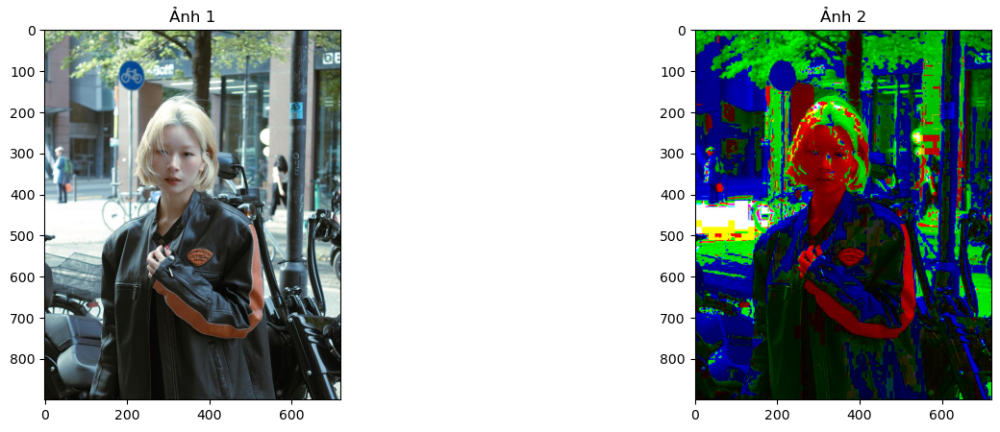

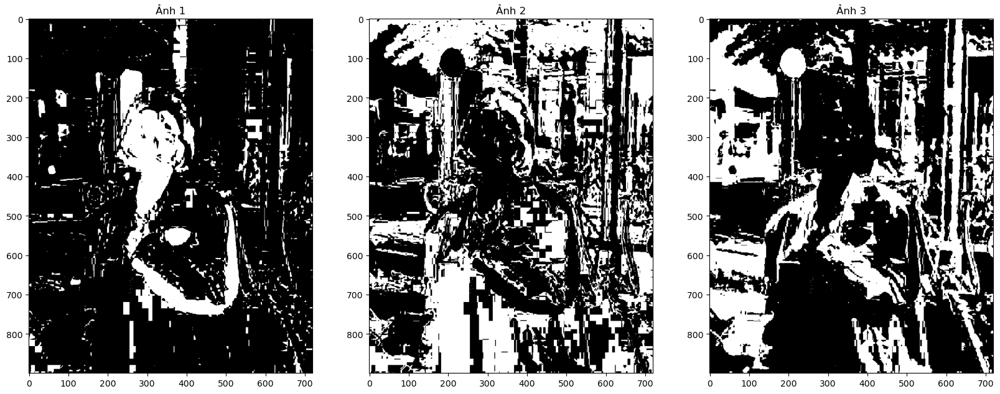

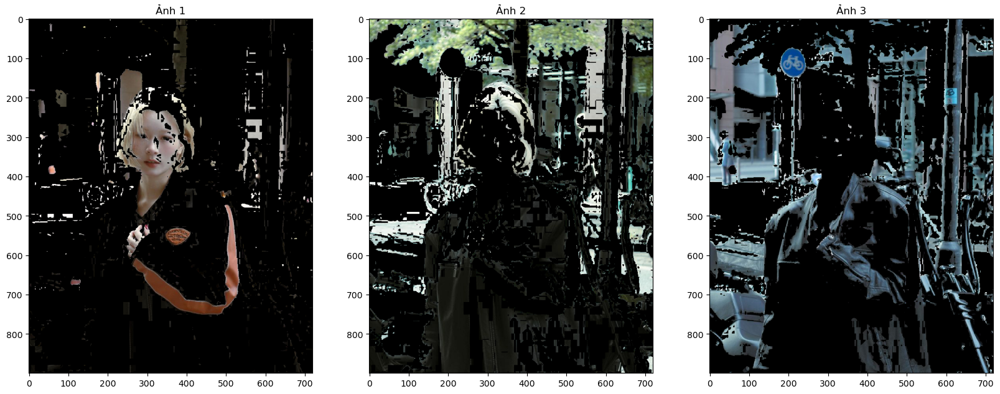

In [28]:
image_maxR_mask = image_4_gray < 0
image_maxG_mask = image_4_gray < 0
image_maxB_mask = image_4_gray < 0

R = image_4_rgbmax[:,:,0]
G = image_4_rgbmax[:,:,1]
B = image_4_rgbmax[:,:,2]

image_maxR_mask[(G == 0) & (B == 0)] = 1
image_maxG_mask[(R == 0) & (B == 0)] = 1
image_maxB_mask[(G == 0) & (R == 0)] = 1

image_maxR = SegmentColorImageByMask(image_4, image_maxR_mask)
image_maxG = SegmentColorImageByMask(image_4, image_maxG_mask)
image_maxB = SegmentColorImageByMask(image_4, image_maxB_mask)

ShowTwoImages(image_4, image_4_rgbmax)
ShowThreeImages(image_maxR_mask, image_maxG_mask, image_maxB_mask)
ShowThreeImages(image_maxR, image_maxG, image_maxB)

### Thưc hiện làm mờ ảnh rồi sau đó làm rõ ảnh và so sánh giá trị độ đo mờ có giống ảnh gốc không

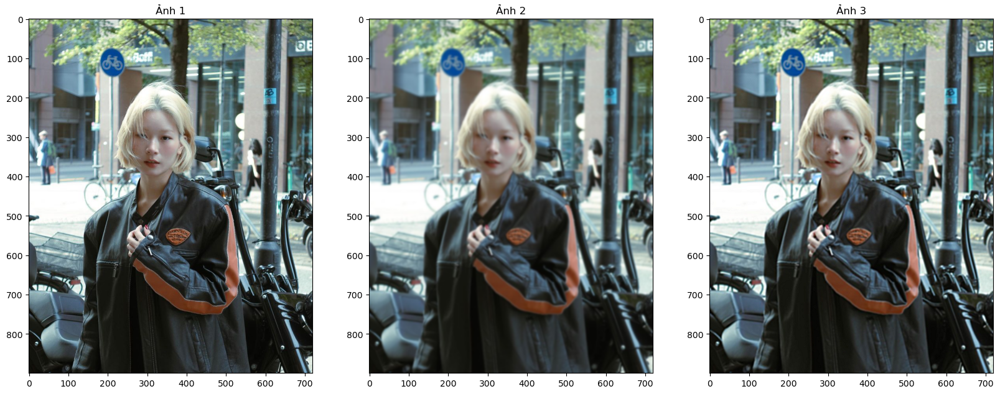

Độ đo mờ của ảnh gốc: 224.4999401834109
Độ đo mờ của ảnh sau khi làm mờ: 9.62858326665036
Độ đo mờ của ảnh sau khi tiếp tục làm rõ: 202.0581458865507


In [29]:
# Làm mờ ảnh
blurred_image = cv2.GaussianBlur(image_4, (11, 11), 0)

# Làm rõ ảnh
sharp_kernel = np.array([[-1, -1, -1],
                        [-1, 9, -1],
                        [-1, -1, -1]])
sharpened_image = cv2.filter2D(blurred_image, -1, sharp_kernel)

ShowThreeImages(image_4, blurred_image, sharpened_image)

# So sánh giá trị độ đo mờ
original_score = cv2.Laplacian(image, cv2.CV_64F).var()
blurred_image_score = cv2.Laplacian(blurred_image, cv2.CV_64F).var()
sharpened_image_score = cv2.Laplacian(sharpened_image, cv2.CV_64F).var()

print(f"Độ đo mờ của ảnh gốc: {original_score}")
print(f"Độ đo mờ của ảnh sau khi làm mờ: {blurred_image_score}")
print(f"Độ đo mờ của ảnh sau khi tiếp tục làm rõ: {sharpened_image_score}")

### Thực hiện làm rõ ảnh rồi sau đó làm mờ ảnh và so sánh giá trị độ đo mờ có giống ảnh gốc không

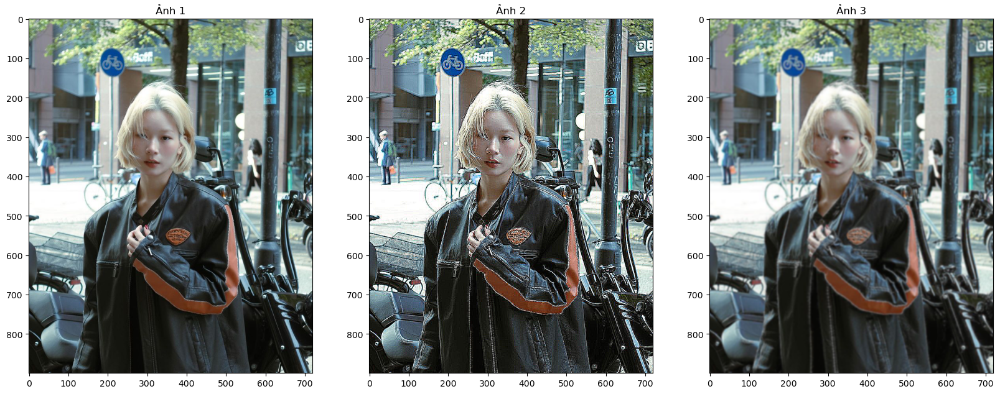

Độ đo mờ của ảnh gốc: 224.4999401834109
Độ đo mờ của ảnh sau khi làm rõ: 19643.7025282402
Độ đo mờ của ảnh sau khi tiếp tục làm mờ: 21.977896077257867


In [30]:
# Làm rõ ảnh
sharp_kernel = np.array([[-1, -1, -1],
                        [-1, 9, -1],
                        [-1, -1, -1]])
sharpened_image = cv2.filter2D(image_4, -1, sharp_kernel)

# Làm mờ ảnh
blurred_image = cv2.GaussianBlur(sharpened_image, (11, 11), 0)

ShowThreeImages(image_4, sharpened_image, blurred_image)

# So sánh giá trị độ đo mờ
original_score = cv2.Laplacian(image, cv2.CV_64F).var()
sharpened_image_score = cv2.Laplacian(sharpened_image, cv2.CV_64F).var()
blurred_image_score = cv2.Laplacian(blurred_image, cv2.CV_64F).var()

print(f"Độ đo mờ của ảnh gốc: {original_score}")
print(f"Độ đo mờ của ảnh sau khi làm rõ: {sharpened_image_score}")
print(f"Độ đo mờ của ảnh sau khi tiếp tục làm mờ: {blurred_image_score}")

### Tìm cạnh và tạo ra các ảnh về cạnh sau : ảnh cạnh ngang, cạnh dọc và ảnh cạnh tổng

In [31]:
#Xây dựng ma trận để xuất ảnh các cạnh của từng vùng của hình ảnh
kernel_sobel_X = np.array(([-1, 0, 1],
                           [-2, 0, 2],
                           [-1, 0, 1]), dtype = "int")

kernel_sobel_Y = np.array(([-1, -2, -1],
                           [0, 0, 0],
                           [1, 2, 1]), dtype = "int")

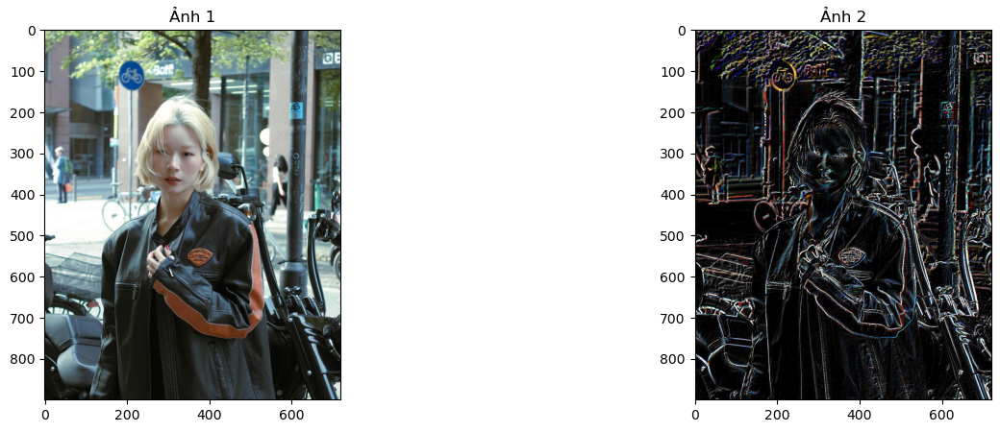

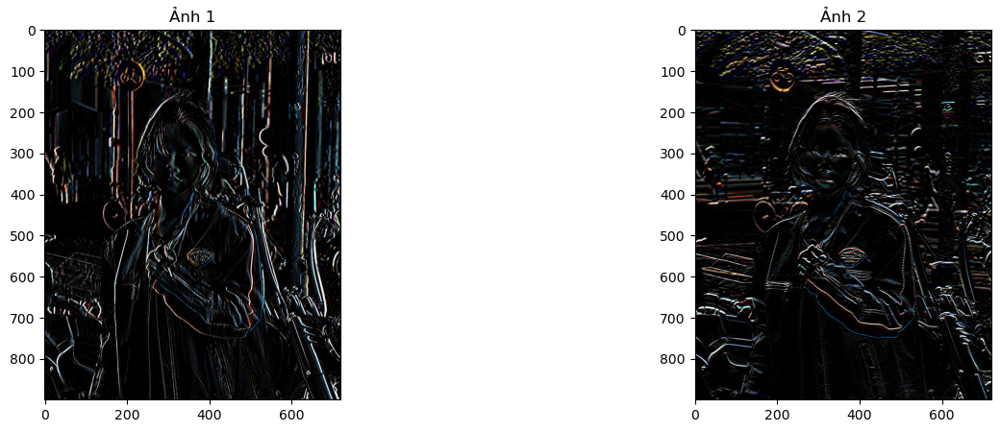

In [32]:
# Xuất ảnh màu
image_color_edge_sobelX = cv2.filter2D(image_4, -1, kernel_sobel_X)
image_color_edge_sobelY = cv2.filter2D(image_4, -1, kernel_sobel_Y)
image_color_edge = image_color_edge_sobelX + image_color_edge_sobelY

ShowTwoImages(image_4, image_color_edge)
ShowTwoImages(image_color_edge_sobelX, image_color_edge_sobelY)

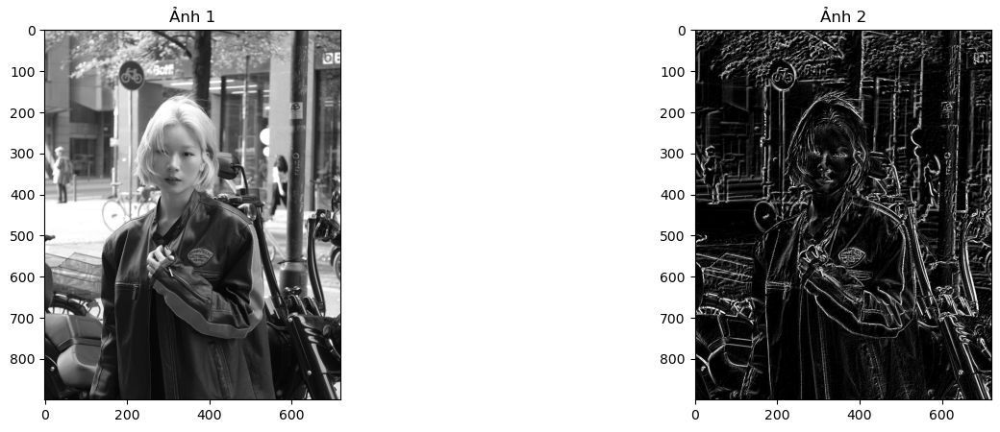

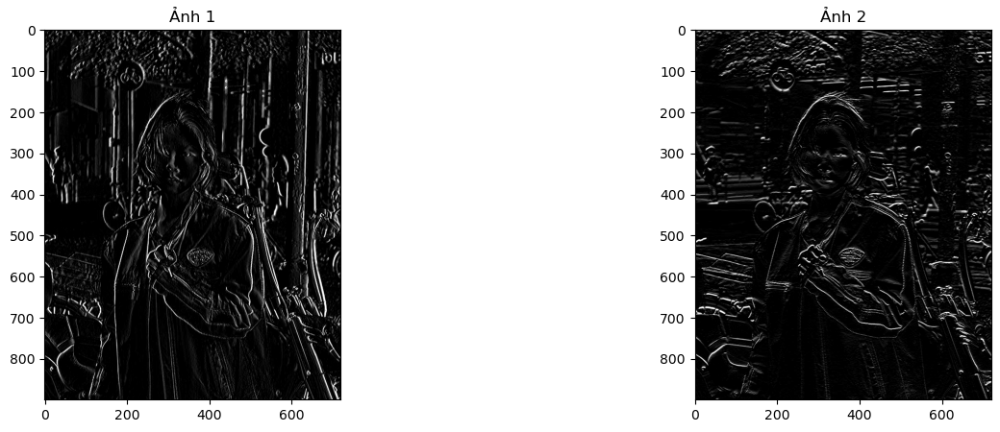

In [33]:
# Xuất ảnh xám
image_gray_edge_sobelX = cv2.filter2D(image_4_gray, -1, kernel_sobel_X)
image_gray_edge_sobelY = cv2.filter2D(image_4_gray, -1, kernel_sobel_Y)
image_gray_edge = image_gray_edge_sobelX + image_gray_edge_sobelY

ShowTwoImages(image_4_gray, image_gray_edge)
ShowTwoImages(image_gray_edge_sobelX, image_gray_edge_sobelY)